In [1]:
import pandas as pd
import numpy as np
import analyze as an
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from PIL import Image
import requests
import cv2
import io


%matplotlib inline
from matplotlib import pyplot as plt

# Enable module reloading
%load_ext autoreload
%autoreload 2

In [2]:
# shows image in Jupyter notebook
def imshow(img):
    import cv2
    import IPython
    _,ret = cv2.imencode('.jpg', img) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)

# Open-image dataset

In first step the dataframes are loaded, we will work with 3 related dataframes:
- image_ids - contains informations about images -> ID, original_url, size etc.
- labels - defined labels for images. Every row contains one label with image ID and confidence, whether the label is valid (range between 0 and 1)
- relationships - contains triplets (for example 'man' + 'in' + 'car') with image id and bounding boxes for those two objects

In [3]:
df_ids, df_labels, df_relationships = an.load_data("./valid/image_ids.csv", 
                                                   "./valid/labels.csv", 
                                                   "./valid/relationships.csv")

## Image IDs

In [4]:
df_ids.head(3)

,ImageID,Subset,OriginalURL,OriginalLandingURL,License,AuthorProfileURL,Author,Title,OriginalSize,OriginalMD5,Thumbnail300KURL,Rotation
0,fe600639ac5f36c1,validation,https://farm2.staticflickr.com/5612/1534025949...,https://www.flickr.com/photos/118815643@N04/15...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/118815643@N04/,LabHacker CD,_GUT6674,242145,0jBpbNION09+r02xkTIBcA==,https://c8.staticflickr.com/6/5612/15340259497...,NaN
1,ba82c70cc6cdf449,validation,https://farm4.staticflickr.com/3859/1527670200...,https://www.flickr.com/photos/125612851@N04/15...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/125612851@N04/,Stockholms stadsarkiv,SE_SSA_0870_Ofört_029,1658910,qMzF2UrrpPdjO+Nhhl6pvQ==,https://c7.staticflickr.com/4/3859/15276702002...,0.0
2,e3ffa4c868b11b15,validation,https://farm6.staticflickr.com/5336/1717037798...,https://www.flickr.com/photos/101125222@N02/17...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/101125222@N02/,Ismaïl Taha,ct26,1085575,MXOLnofbdq410OH34woSeg==,https://c3.staticflickr.com/6/5336/17170377986...,0.0


In [5]:
df_ids.describe(include='all')

,ImageID,Subset,OriginalURL,OriginalLandingURL,License,AuthorProfileURL,Author,Title,OriginalSize,OriginalMD5,Thumbnail300KURL,Rotation
count,41620,41620,41620,41620,41620,41620,41620,41620,4.162000e+04,41620,40100,36302.000000
unique,41620,1,41620,41620,1,17527,17298,39318,NaN,41620,40100,NaN
top,0d01030120cb441b,validation,https://farm2.staticflickr.com/94/242759902_e3...,https://www.flickr.com/photos/lacatholique/804...,https://creativecommons.org/licenses/by/2.0/,https://www.flickr.com/people/msvg/,Michael Gil,Untitled,NaN,2ZeAdvb8ZfzeG7lOM33G2Q==,https://c4.staticflickr.com/8/7306/15732622814...,NaN
freq,1,41620,1,1,41620,55,55,753,NaN,1,1,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.000560e+06,NaN,NaN,2.905625
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.448772e+06,NaN,NaN,26.688594
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.106000e+03,NaN,NaN,0.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.546878e+05,NaN,NaN,0.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.059660e+06,NaN,NaN,0.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.826829e+06,NaN,NaN,0.000000


In [6]:
df_ids.columns

Index(['ImageID', 'Subset', 'OriginalURL', 'OriginalLandingURL', 'License',
       'AuthorProfileURL', 'Author', 'Title', 'OriginalSize', 'OriginalMD5',
       'Thumbnail300KURL', 'Rotation'],
      dtype='object')

The most important columns (for our goal):
- ImageID - the unique ID of the image
- OriginalURL - the original URL, where the image can be found
- OriginalSize - the download size of the original image (mean value: 2.25 MB / image)

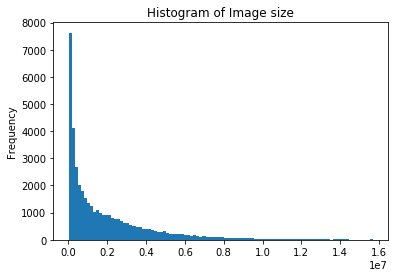

In [7]:
df_ids['OriginalSize'].plot.hist(bins=100, title='Histogram of Image size')

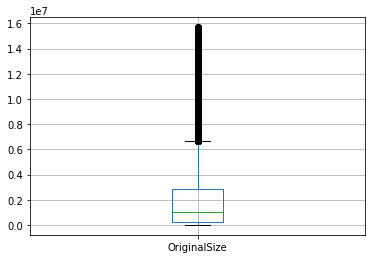

In [8]:
df_ids.boxplot(column=['OriginalSize'])

Most of images are having size from the range (0.25 MB,  2.83 MB), but there is a significant number of bigger images.

We take a look at some example images:

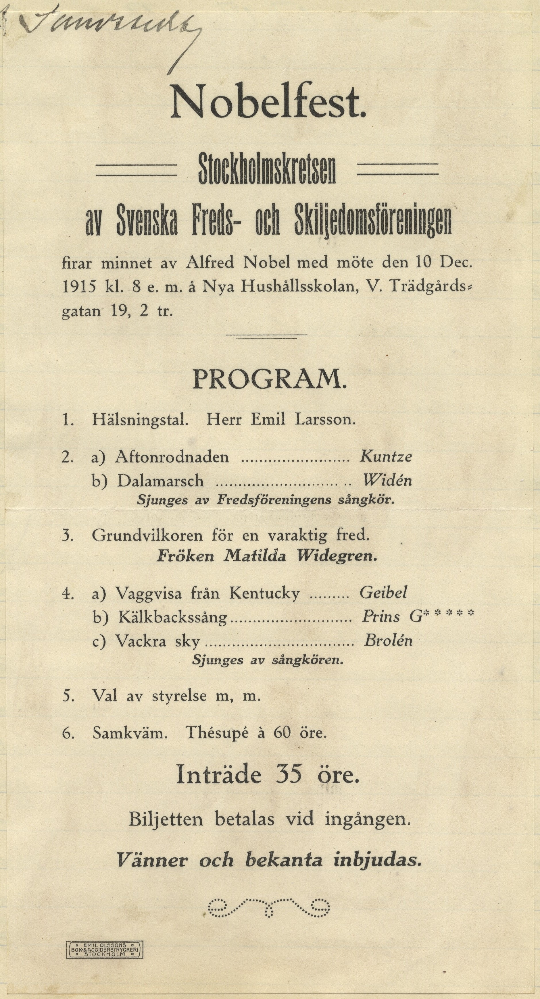

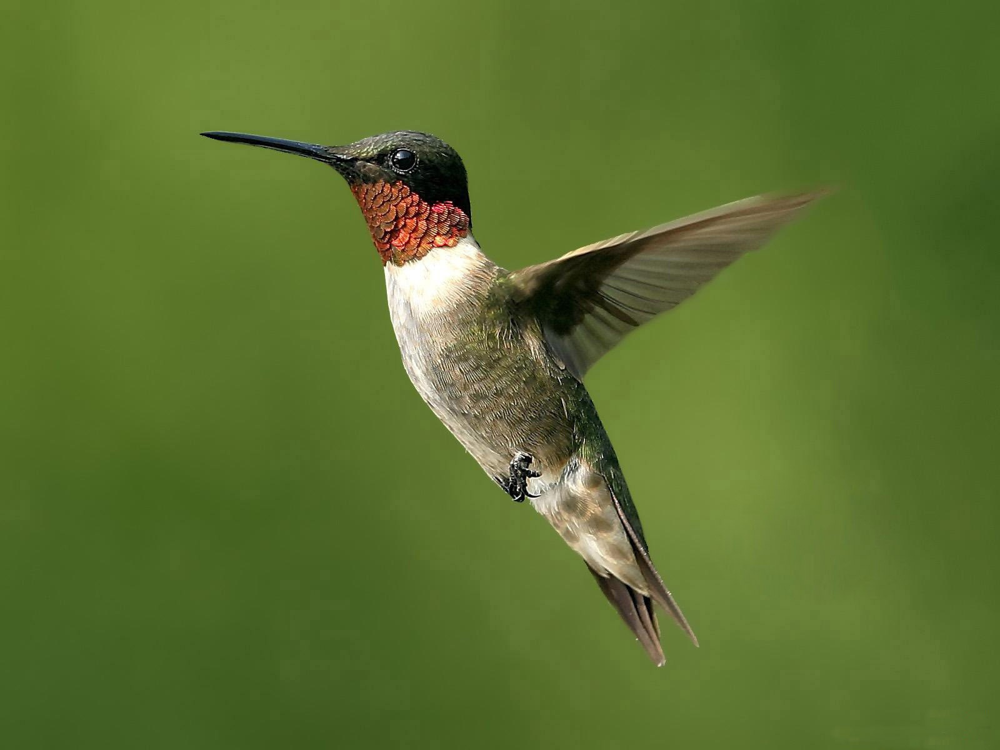

In [44]:
imgs = []

for index, url in enumerate(df_ids['OriginalURL'].values[0:4]):
    img = an.load_image(url)
    if img is not None:
        imshow(img)


## Labels

In [13]:
df_labels.head(3)

,ImageID,Source,LabelName,Confidence
0,0001eeaf4aed83f9,verification,/m/0cmf2,1
1,0004886b7d043cfd,verification,/m/01g317,0
2,0004886b7d043cfd,verification,/m/04hgtk,0


First we decode the encoded label names

In [14]:
decode_dict = an.get_decode_dict()
def decode_label(label_code):
    return decode_dict[label_code]

df_labels['DecodedName'] = df_labels['LabelName'].apply(decode_label)

In [15]:
df_labels.head(3)

,ImageID,Source,LabelName,Confidence,DecodedName
0,0001eeaf4aed83f9,verification,/m/0cmf2,1,Airplane
1,0004886b7d043cfd,verification,/m/01g317,0,Person
2,0004886b7d043cfd,verification,/m/04hgtk,0,Human head


In [16]:
df_labels.columns

Index(['ImageID', 'Source', 'LabelName', 'Confidence', 'DecodedName'], dtype='object')

The most important columns:
- ImageID - ID of the image
- LabelName - the encoded name of the label
- Source: indicates how the annotation was created: 
    - verification are labels verified by in-house annotators at Google. 
    - crowdsource-verification are labels verified from the Crowdsource app.
    - machine are machine-generated labels.
- Confidence: Labels that are human-verified to be present in an image have confidence = 1 (positive labels). Labels that are human-verified to be absent from an image have confidence = 0 (negative labels). Machine-generated labels have fractional confidences, generally >= 0.5. The higher the confidence, the smaller the chance for the label to be a false positive.


We are interested only in images with Source='verification' and Confidence=1

In [45]:
df_labels = df_labels[(df_labels['Source'] == 'verification') & (df_labels['Confidence'] == 1)]

We analyze the frequency of labels, because we are searching for training set with lower number of different classes (around 10) and we need more images to be able to train our models properly.

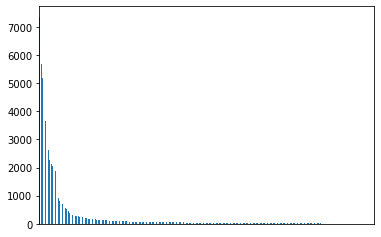

In [18]:
df_labels['LabelName'].value_counts().plot(kind='bar')

plt.xticks([])
plt.show()

In [19]:
df_labels['DecodedName'].value_counts()

Clothing           7358
Person             7191
Mammal             6143
Human body         5686
Plant              5365
                   ... 
Training bench        1
Spatula               1
Flying disc           1
Stethoscope           1
Pressure cooker       1
Name: DecodedName, Length: 570, dtype: int64

The distribution of labels is very unbalanced, there are many classes with less than 500 occurences.

We take a look at top 10 labels.

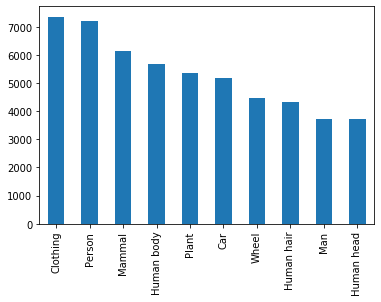

In [20]:
df_labels['DecodedName'].value_counts()[:10].plot(kind='bar')

For a better overview we take a look at the first image for every label:

Clothing


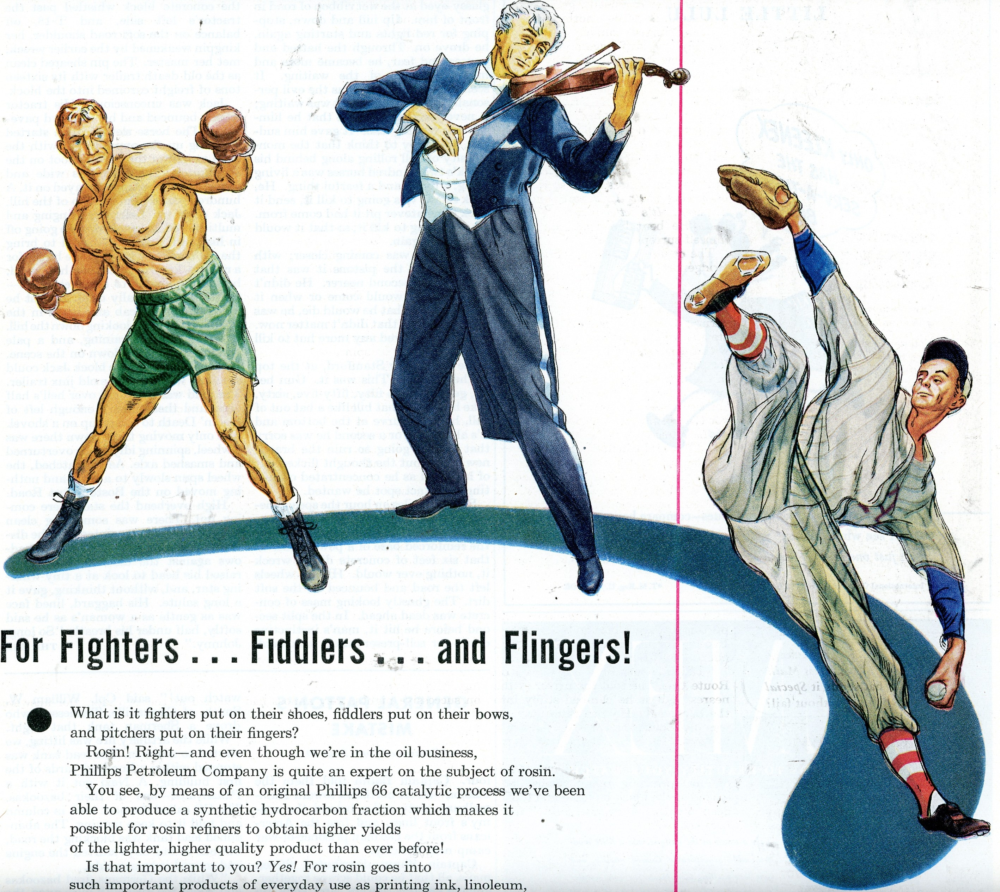

------------------------------------------------------------
Person


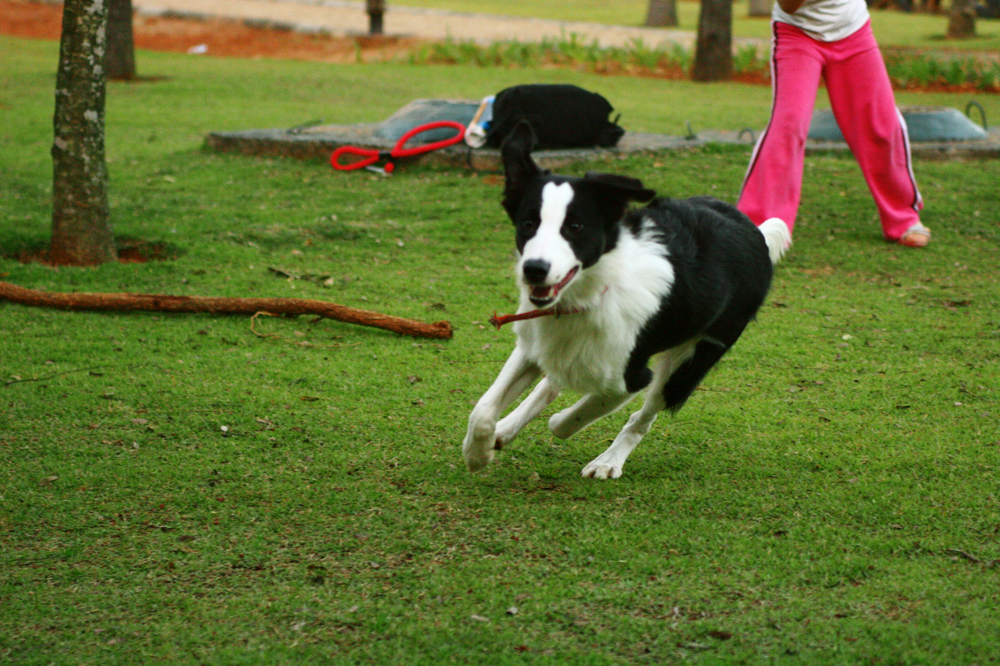

------------------------------------------------------------
Mammal


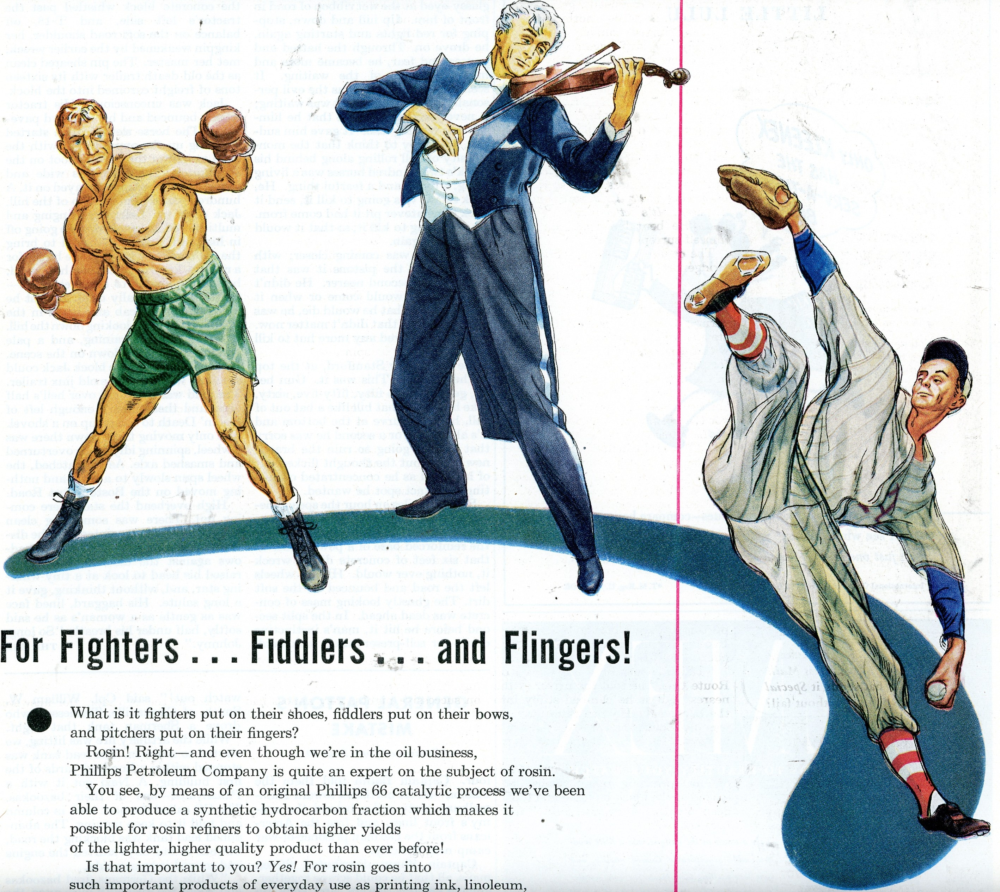

------------------------------------------------------------
Human body


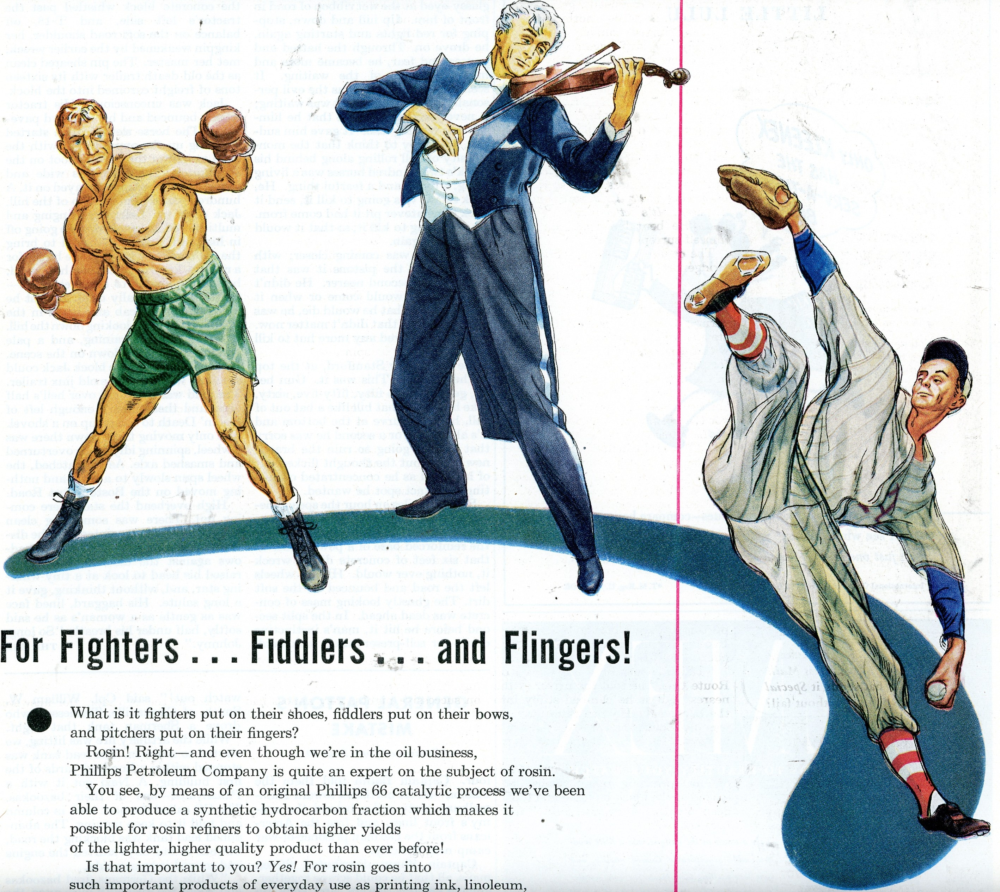

------------------------------------------------------------
Plant


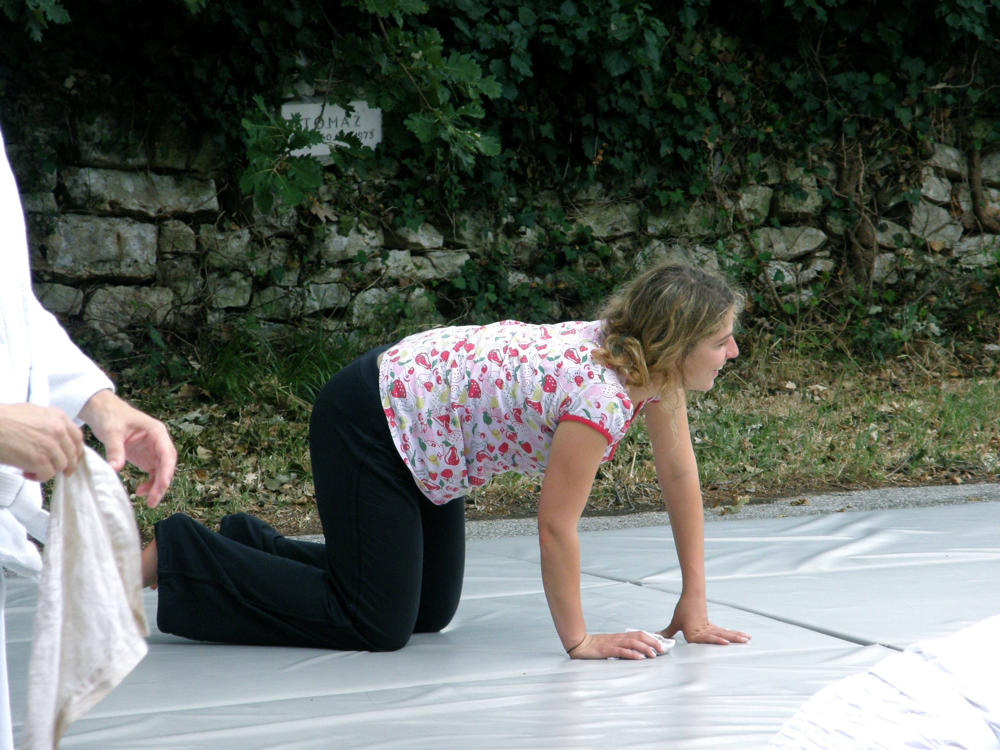

------------------------------------------------------------
Car


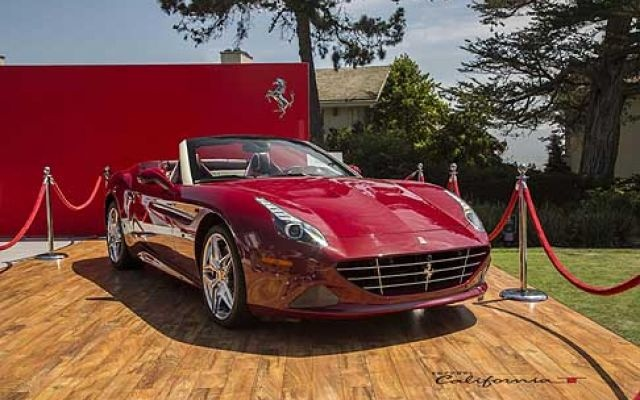

------------------------------------------------------------
Wheel


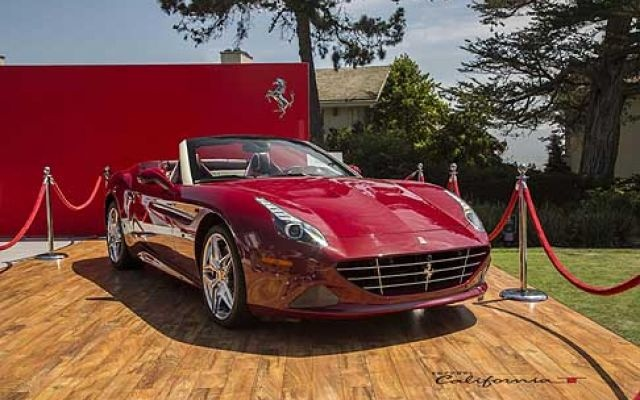

------------------------------------------------------------
Human hair


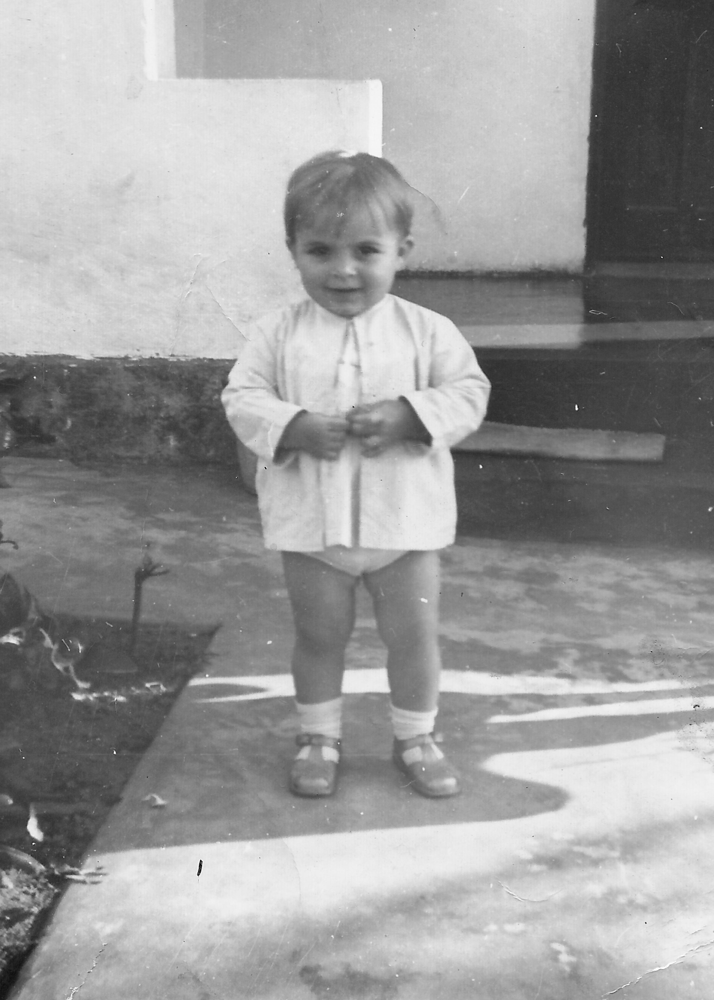

------------------------------------------------------------
Man


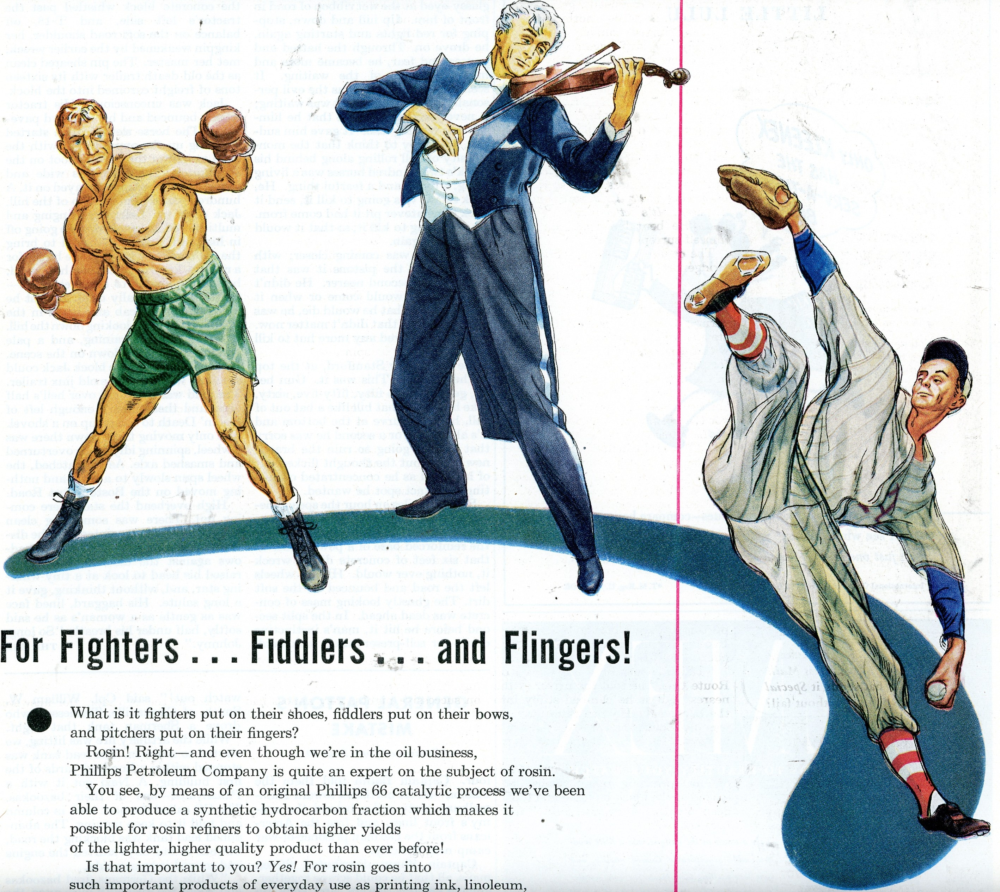

------------------------------------------------------------
Human head


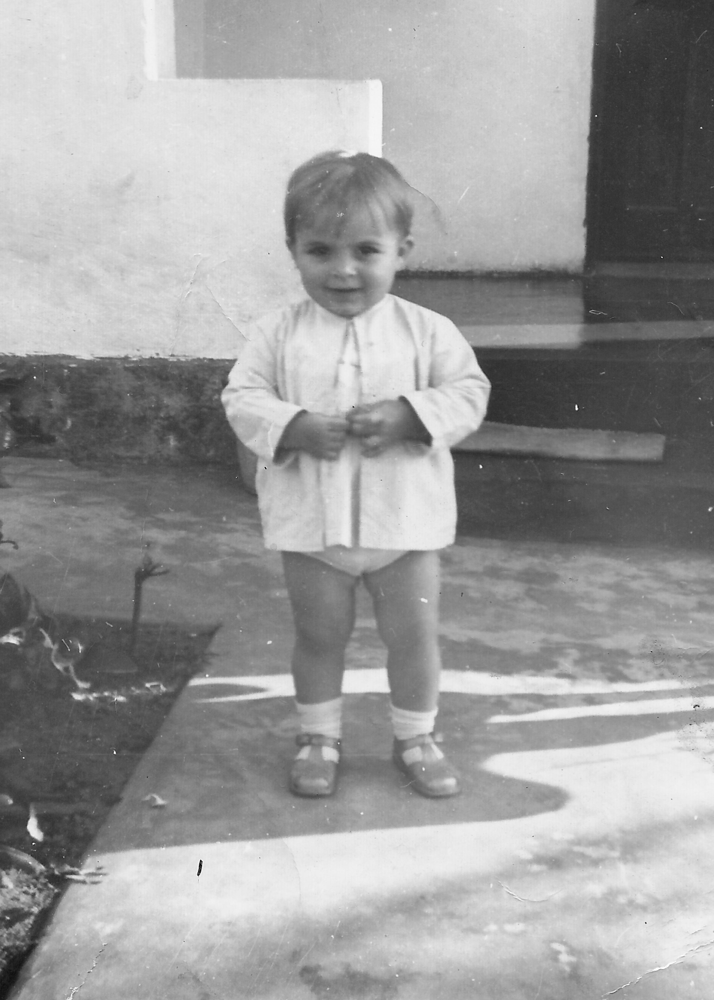

------------------------------------------------------------


In [41]:
top_labels = df_labels['LabelName'].value_counts()[:10].index.values

for label in top_labels:
    image_id = df_labels[df_labels['LabelName'] == label]['ImageID'].values[0]
    url = df_ids[df_ids['ImageID'] == image_id]['OriginalURL'].values[0]
    img = an.load_image(url)
    if img is not None:
        print(decode_label(label))
        imshow(img)
        print('------------------------------------------------------------')

## Relationships

In [180]:
df_relationships.head(3)

,ImageID,LabelName1,LabelName2,XMin1,XMax1,YMin1,YMax1,XMin2,XMax2,YMin2,YMax2,RelationshipLabel
0,fe600639ac5f36c1,/m/05r655,/m/0hg7b,0.360825,0.684831,0.132743,0.716814,0.466863,0.555228,0.351770,0.495575,holds
1,fe600639ac5f36c1,/m/03bt1vf,/m/0hg7b,0.363770,0.686303,0.130531,0.716814,0.466863,0.555228,0.351770,0.495575,holds
2,07bb1574590ad7fd,/m/01mzpv,/m/01y9k5,0.290625,0.510938,0.463466,0.906054,0.237500,0.489062,0.413361,0.843424,at


We decode the class names again

In [47]:
df_relationships['DecodedName1'] = df_relationships['LabelName1'].apply(decode_label)
df_relationships['DecodedName2'] = df_relationships['LabelName2'].apply(decode_label)

df_relationships.head(3)

,ImageID,LabelName1,LabelName2,XMin1,XMax1,YMin1,YMax1,XMin2,XMax2,YMin2,YMax2,RelationshipLabel,DecodedName1,DecodedName2
0,fe600639ac5f36c1,/m/05r655,/m/0hg7b,0.360825,0.684831,0.132743,0.716814,0.466863,0.555228,0.351770,0.495575,holds,Girl,Microphone
1,fe600639ac5f36c1,/m/03bt1vf,/m/0hg7b,0.363770,0.686303,0.130531,0.716814,0.466863,0.555228,0.351770,0.495575,holds,Woman,Microphone
2,07bb1574590ad7fd,/m/01mzpv,/m/01y9k5,0.290625,0.510938,0.463466,0.906054,0.237500,0.489062,0.413361,0.843424,at,Chair,Desk


In [48]:
df_relationships.describe(include='all')

,ImageID,LabelName1,LabelName2,XMin1,XMax1,YMin1,YMax1,XMin2,XMax2,YMin2,YMax2,RelationshipLabel,DecodedName1,DecodedName2
count,3991,3991,3991,3991.000000,3991.000000,3991.000000,3991.000000,3991.000000,3991.000000,3991.000000,3991.000000,3991,3991,3991
unique,1537,31,43,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10,31,43
top,56e803d5e8c580e0,/m/01mzpv,/m/083vt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,is,Chair,Wooden
freq,69,902,1327,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2573,902,1327
mean,NaN,NaN,NaN,0.310796,0.692468,0.347189,0.807709,0.283309,0.722056,0.405729,0.826241,NaN,NaN,NaN
std,NaN,NaN,NaN,0.272860,0.271225,0.250327,0.211735,0.270793,0.270249,0.246348,0.207785,NaN,NaN,NaN
min,NaN,NaN,NaN,0.000000,0.019146,0.000000,0.068584,0.000000,0.019146,0.000000,0.068584,NaN,NaN,NaN
25%,NaN,NaN,NaN,0.057813,0.486009,0.118750,0.675497,0.020589,0.516659,0.197917,0.712945,NaN,NaN,NaN
50%,NaN,NaN,NaN,0.254737,0.744838,0.335417,0.876106,0.221239,0.790560,0.438235,0.912664,NaN,NaN,NaN
75%,NaN,NaN,NaN,0.512500,0.946989,0.557522,0.997788,0.475000,0.980882,0.595833,0.998195,NaN,NaN,NaN


In [8]:
tr_relationships.columns

Index(['ImageID', 'LabelName1', 'LabelName2', 'XMin1', 'XMax1', 'YMin1',
       'YMax1', 'XMin2', 'XMax2', 'YMin2', 'YMax2', 'RelationshipLabel'],
      dtype='object')

The most important columns:
- ImageID: the image this relationship instance lives in.
- LabelName1: the label of the first object in the relationship triplet.
- XMin1,XMax1,YMin1,YMax1: normalized bounding box coordinates of the bounding box of the first object.
- LabelName2: the label of the second object in the relationship triplet, or an attribute.
- XMin2, XMax2, YMin2, YMax2: If the relationship is between a pair of objects: normalized bounding box coordinates of the bounding box of the second object. For an object-attribute relationship (RelationLabel="is"): normalized bounding box of the first object (repeated). In this case, LabelName2 is an attribute.
- RelationLabel: the label of the relationship ("is" in case of attributes).

### labels

We will check out the labels used in relationship triplets

In [50]:
len(set(df_relationships["LabelName1"].values).union(set(df_relationships["LabelName2"].values)))

53

There are 62 unique labels, which are having relationships with other objects on images.

We are searching for the top 10 mostfrequent label in this case as well

In [57]:
top_labels1 = df_relationships.groupby('DecodedName1').count().sort_values('ImageID', ascending=False).head(10)['ImageID'].to_frame()

In [58]:
top_labels2 = df_relationships.groupby('DecodedName2').count().sort_values('ImageID', ascending=False).head(10)['ImageID'].to_frame()

In [59]:
for i in range(10):
    if(top_labels2.index[i] in top_labels1.index):
        top_labels1.loc[top_labels2.index[i]] += top_labels2.iloc[i].values[0]
    else:
        top_labels1 = top_labels1.append(top_labels2.iloc[i])

In [60]:
top_df = top_labels1.head(10).sort_values('ImageID', ascending=False)
top_df

,ImageID
DecodedName1,
Table,1342
Chair,960
Man,600
Desk,302
Bottle,294
Woman,212
Girl,155
Handbag,125
Piano,104


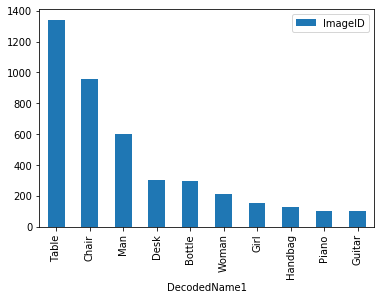

In [66]:
top = top_df.head(10).index.values
top_df.plot(kind='bar')

The most frequent label between relationships is 'Table' with 151145 occurences. The second one is 'Chair' with 135145. From the third label ('Man') the number of occurencies is rapidly decreasing.

#### relationship label

this dataframe contains a relationship label as well (for example 'at', 'on'). We are searching for relationship labels used between top 10 entity labels.

In [69]:
df_relationships['RelationshipLabel'].unique()

array(['holds', 'at', 'is', 'plays', 'on', 'interacts_with', 'inside_of',
       'hits', 'wears', 'under'], dtype=object)

There are overall 10 unique relationship labels.

We are mainly interested about relationship labels between top 10 entity labels

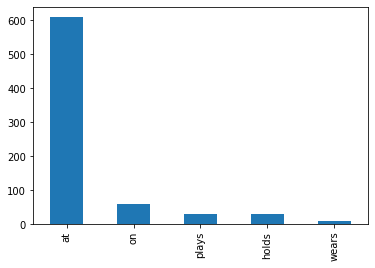

In [74]:
df_relationships[(df_relationships['DecodedName1'].isin(top)) & (df_relationships['DecodedName2'].isin(top))]['RelationshipLabel'].value_counts().plot(kind='bar')

Between top 10 classes are 5 types of relationship: 'at', 'on', 'holds', 'plays', 'wears'. At is the absolutely most frequent.

### images

We decided to use images with defined triplets, and potentionally work with visual object relationships

We find out, how much images we can use, if we want to train our model with only 10 most frequent labels

In [75]:
ids = df_relationships[(df_relationships['DecodedName1'].isin(top)) & (df_relationships['DecodedName2'].isin(top))]['ImageID']

In [76]:
ids.shape[0]

737

In [77]:
ids.nunique()

261

In train set we are having 34816 images and 135832 triplets with boundig boxes. We are going to use this images for training our model.

In [78]:
image_ids = ids.unique()   # ids of images with triplets

Example of an image with labeled triplets:

Woman at Table
Man at Table
Man at Table


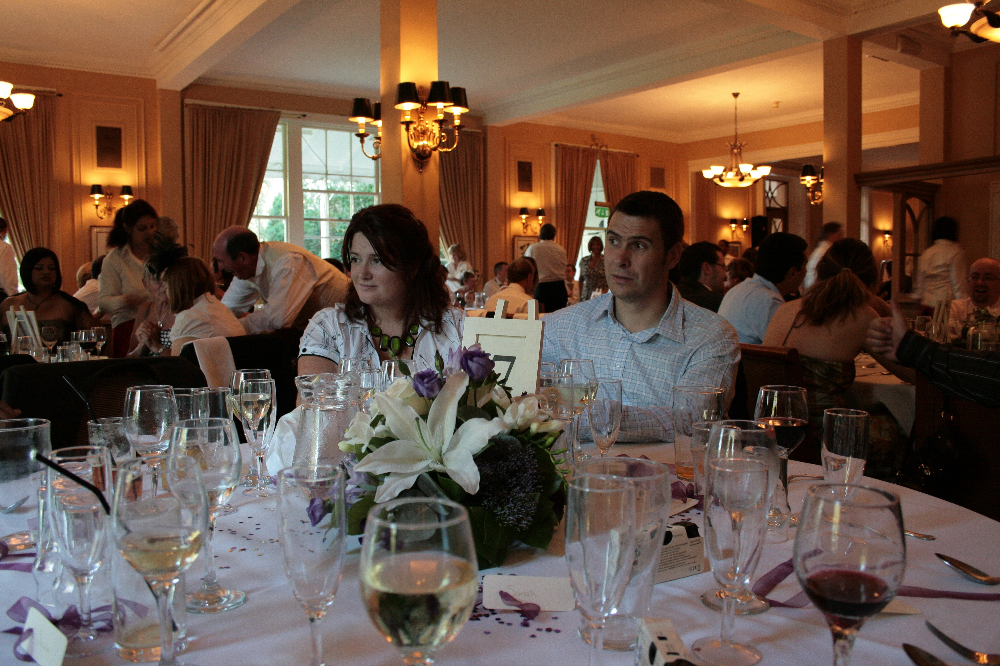

In [98]:
for ind, row in df_relationships[(df_relationships['ImageID'] == image_ids[2]) &
                                 (df_relationships['DecodedName1'].isin(top)) & 
                                 (df_relationships['DecodedName2'].isin(top))].iterrows():
    print(row['DecodedName1'] + " " + row['RelationshipLabel'] + " " + row['DecodedName2'])
    
url = df_ids[df_ids['ImageID'] == image_ids[2]]['OriginalURL'].values[0]
img = an.load_image(url)
imshow(img)

Simple image can have more than one triplet, which brings us to decision, whether to use all the labels for one image, or work with only one triplet per image.

# Data preprocessing

We decided to work with images with labeled visual relationship triplets, we will use the top 10 most frequent object labels

In [100]:
urls = df_ids.loc[df_ids['ImageID'].isin(image_ids)]['OriginalURL'].values

In [101]:
len(urls)

261